In [1]:
import pickle
import pandas as pd
import numpy as np

from matplotlib import pyplot as plt
from shapely.geometry import Polygon
from descartes.patch import PolygonPatch

In [2]:
import os
import sys
cwd = os.getcwd()
ROOT = os.path.dirname(os.path.dirname(cwd))
sys.path.append(ROOT)

from example_code.data.data_reader import SinD

# Labels

In [3]:
# Create a Polygon
poly = Polygon(shell=[(0, 0), (1, 0), (1, 1), (0, 1), (0, 0)], holes=[[(0.2, 0.2), (0.2, 0.8), (0.8, 0.8), (0.8, 0.2), (0.2, 0.2)]])
print(poly)

POLYGON ((0 0, 1 0, 1 1, 0 1, 0 0), (0.2 0.2, 0.2 0.8, 0.8 0.8, 0.8 0.2, 0.2 0.2))


In [4]:
# Specify the path to the .pkl file
file_path = '../../resources/sind_labels.pkl'

# Open and load the file
with open(file_path, 'rb') as f:
    data = pickle.load(f)

df = pd.DataFrame(data)
print(df[0].unique())


# Now loaded_object contains the data that was saved in the .pkl file


[3 4 5 2 6 1 0]


# Sind Data

In [5]:
with open('../../resources/sind.pkl', 'rb') as f:
    data = pickle.load(f)

data.shape

(513136, 540)

In [6]:
len(data[0])

#90*6 = 540, 90 is the input_len and 6 are the 6 different variables recorded (x, y, vx. vy, ax. ay)

540

In [7]:
len(data)

# number of people recorded 1656 (-66 exclude 8_02_1 file) multiplied by the avg of (trajectory path - 90)
# if velocity_filter True then exclude data below velocity threshold 

513136

In [8]:
sind = SinD()
# data = sind.data(input_len=90, velocity_filter=False)

In [9]:
dataset = sind.pedestrian_data
len(dataset), len(dataset[0]), len(dataset[0]['x'])

(1654, 6, 224)

In [10]:
# Trajectory Length
length = {}
for i in range(len(dataset)):
    length[i] = dataset[i]['x'].size

df_trajectory_lengths = pd.DataFrame(length.values())
df_trajectory_lengths.mean()

0    389.041112
dtype: float64

In [11]:
len(dataset[0]['x']), (224-90)

(224, 134)

In [12]:
# Data with less than input_len is not included, e.g. the last _data (id == len(dataset)-1)
print(dataset[len(dataset)-1]['x'].shape[0], (df_trajectory_lengths > 90).sum())
df_trajectory_lengths = df_trajectory_lengths[df_trajectory_lengths[0] > 90]
df_trajectory_lengths.reset_index(drop=True, inplace=True)

70 0    1240
dtype: int64


In [13]:
print((df_trajectory_lengths - 90).sum())
(df_trajectory_lengths-90).mean()*len(df_trajectory_lengths)

0    513136
dtype: int64


0    513136.0
dtype: float64

# Create Dataset

In [14]:
sind = SinD()

In [15]:
pd.DataFrame(sind.pedestrian_data[0]) # 0 is the first pedestrian

,x,y,vx,vy,ax,ay
0,19.959110,2.241932,0.802134,2.107355,-0.512478,-0.969077
1,20.031912,2.440845,0.748808,2.005833,-0.528675,-1.005175
2,20.070969,2.575951,0.688343,1.888400,-0.581255,-1.122361
3,20.096007,2.672927,0.618437,1.747485,-0.649935,-1.289731
4,20.133727,2.757631,0.545187,1.593783,-0.691274,-1.413882
...,...,...,...,...,...,...
219,22.195683,29.408266,-0.086677,1.165566,0.005231,-0.035234
220,22.185654,29.491430,-0.091368,1.138521,-0.014997,-0.126444
221,22.171614,29.569056,-0.100216,1.103892,-0.043490,-0.211660
222,22.148629,29.660649,-0.112928,1.071331,-0.075908,-0.255772


In [16]:
# Trajectory Length
length = {}
for i in range(len(sind.pedestrian_data)):
    length[i] = sind.pedestrian_data[i]['x'].size

df_trajectory_lengths = pd.DataFrame(length.values())
(df_trajectory_lengths // 90 ).sum() + (df_trajectory_lengths % 90 != 0).sum()

0    7990
dtype: int64

In [17]:
import torch
import numpy as np
import pandas as pd

def split_pedestrian_data(data, chunk_size=90):
    """
    Efficiently split pedestrian data into fixed-size chunks and convert to torch.Tensor,
    padding with -1 where data do not exist.

    :param data: Dictionary of pedestrian data.
    :param chunk_size: Size of each chunk.
    :return: Dictionary with split and padded data, DataFrame with pedestrian IDs.
    """
    split_data = {}
    idx = 0

    for _, attributes in data.items():
        # Stack 'x', 'y', 'vx', 'vy', 'ax', 'ay' vertically to get a 2D array for each
        combined_data = np.stack([
            attributes['x'], attributes['y'],
            attributes['vx'], attributes['vy'],
            attributes['ax'], attributes['ay']
        ], axis=1)

        # Calculate the number of chunks and the number of items in the last chunk
        total_length = len(attributes['x'])
        num_chunks = (total_length + chunk_size - 1) // chunk_size  # Ceiling division

        for i in range(num_chunks):
            start_index = i * chunk_size
            end_index = min(start_index + chunk_size, total_length)

            # Slice the combined data for this chunk
            chunk = combined_data[start_index:end_index]

            # Padding if necessary
            if chunk.shape[0] < chunk_size:
                pad_length = chunk_size - chunk.shape[0]
                chunk = np.pad(chunk, ((0, pad_length), (0, 0)), mode='constant', constant_values=1000)

            # Splitting combined data back into coords, velocity, and acceleration, and converting to tensors
            split_data[idx] = {
                'coords': torch.tensor(chunk[:, :2], dtype=torch.float32),
                'velocity': torch.tensor(chunk[:, 2:4], dtype=torch.float32),
                'acceleration': torch.tensor(chunk[:, 4:], dtype=torch.float32)
            }

            idx += 1

    return split_data

split_data = split_pedestrian_data(sind.pedestrian_data)
split_data, len(split_data)

({0: {'coords': tensor([[19.9591,  2.2419],
           [20.0319,  2.4408],
           [20.0710,  2.5760],
           [20.0960,  2.6729],
           [20.1337,  2.7576],
           [20.1693,  2.8515],
           [20.1911,  2.9818],
           [20.2017,  3.1081],
           [20.2037,  3.2145],
           [20.2002,  3.3037],
           [20.1913,  3.3898],
           [20.1930,  3.4760],
           [20.1965,  3.5816],
           [20.1994,  3.7097],
           [20.2023,  3.8215],
           [20.2094,  3.9122],
           [20.2290,  4.0003],
           [20.2625,  4.1017],
           [20.2870,  4.2266],
           [20.3005,  4.3613],
           [20.3069,  4.4879],
           [20.3069,  4.6006],
           [20.2999,  4.7013],
           [20.3029,  4.8017],
           [20.3114,  4.9245],
           [20.3286,  5.0643],
           [20.3450,  5.1845],
           [20.3633,  5.2807],
           [20.3983,  5.3840],
           [20.4400,  5.5003],
           [20.4666,  5.6413],
           [20.4953,  5.78

In [18]:
dt = split_data[0]
pd.DataFrame(dt['coords']), len(split_data)

(            0          1
 0   19.959110   2.241932
 1   20.031912   2.440845
 2   20.070969   2.575951
 3   20.096006   2.672927
 4   20.133726   2.757631
 ..        ...        ...
 85  21.255077  12.538912
 86  21.263145  12.686708
 87  21.254648  12.819086
 88  21.241259  12.927289
 89  21.221130  13.040629
 
 [90 rows x 2 columns],
 7990)

In [19]:
split_data[len(split_data)-1]['velocity']

tensor([[ 2.0813e-01,  5.6613e-01],
        [ 1.9204e-01,  5.0719e-01],
        [ 1.7495e-01,  4.4160e-01],
        [ 1.5774e-01,  3.6850e-01],
        [ 1.4225e-01,  2.9155e-01],
        [ 1.2907e-01,  2.1611e-01],
        [ 1.1530e-01,  1.4593e-01],
        [ 9.8643e-02,  8.3886e-02],
        [ 8.2043e-02,  3.0636e-02],
        [ 6.6171e-02, -1.1430e-02],
        [ 5.1449e-02, -4.0846e-02],
        [ 3.7411e-02, -6.0261e-02],
        [ 2.4867e-02, -7.1549e-02],
        [ 1.6267e-02, -7.5093e-02],
        [ 1.3833e-02, -7.1686e-02],
        [ 1.7465e-02, -6.3658e-02],
        [ 2.6723e-02, -5.4611e-02],
        [ 4.0672e-02, -4.7653e-02],
        [ 5.8139e-02, -4.8597e-02],
        [ 7.8453e-02, -6.0483e-02],
        [ 1.0324e-01, -8.5776e-02],
        [ 1.3167e-01, -1.2166e-01],
        [ 1.6000e-01, -1.6488e-01],
        [ 1.8618e-01, -2.1178e-01],
        [ 2.1077e-01, -2.5842e-01],
        [ 2.3216e-01, -3.0184e-01],
        [ 2.5262e-01, -3.3760e-01],
        [ 2.7253e-01, -3.596

In [20]:
i= 2
len(split_data[i]['coords']), split_data[i]['coords'][0], split_data[i]['coords'][43], split_data[i]['coords'][44], split_data[i]['coords'][-1]

(90,
 tensor([22.2230, 24.5502]),
 tensor([22.1227, 29.7738]),
 tensor([1000., 1000.]),
 tensor([1000., 1000.]))

In [21]:
len(split_data[i]['velocity']), split_data[i]['velocity'][0], split_data[i]['velocity'][43], split_data[i]['velocity'][44], split_data[i]['velocity'][-1]

(90,
 tensor([0.1631, 1.2685]),
 tensor([-0.1263,  1.0448]),
 tensor([1000., 1000.]),
 tensor([1000., 1000.]))

In [22]:
len(split_data[i]['acceleration']), split_data[i]['acceleration'][0], split_data[i]['acceleration'][43], split_data[i]['acceleration'][44], split_data[i]['acceleration'][-1]

(90,
 tensor([-0.1590,  0.1482]),
 tensor([-0.0984, -0.2594]),
 tensor([1000., 1000.]),
 tensor([1000., 1000.]))

In [23]:
8000%512

320

In [24]:
split_data # check 965 with all zeros

{0: {'coords': tensor([[19.9591,  2.2419],
          [20.0319,  2.4408],
          [20.0710,  2.5760],
          [20.0960,  2.6729],
          [20.1337,  2.7576],
          [20.1693,  2.8515],
          [20.1911,  2.9818],
          [20.2017,  3.1081],
          [20.2037,  3.2145],
          [20.2002,  3.3037],
          [20.1913,  3.3898],
          [20.1930,  3.4760],
          [20.1965,  3.5816],
          [20.1994,  3.7097],
          [20.2023,  3.8215],
          [20.2094,  3.9122],
          [20.2290,  4.0003],
          [20.2625,  4.1017],
          [20.2870,  4.2266],
          [20.3005,  4.3613],
          [20.3069,  4.4879],
          [20.3069,  4.6006],
          [20.2999,  4.7013],
          [20.3029,  4.8017],
          [20.3114,  4.9245],
          [20.3286,  5.0643],
          [20.3450,  5.1845],
          [20.3633,  5.2807],
          [20.3983,  5.3840],
          [20.4400,  5.5003],
          [20.4666,  5.6413],
          [20.4953,  5.7824],
          [20.5301,  5.9009

In [25]:
len(split_data)//1024, len(split_data)%1024 # 7 batches and 1 last batch with 822 values

(7, 822)

In [26]:
from torch.utils.data import DataLoader
from tqdm import tqdm

training_dataloader = DataLoader(
        split_data,
        batch_size=1024,
        num_workers=0,
    )
 
for batch_id, data_split_batch in enumerate(
        tqdm(training_dataloader)
    ):
    print(data_split_batch)
    break

  0%|          | 0/8 [00:00<?, ?it/s]

{'coords': tensor([[[  19.9591,    2.2419],
         [  20.0319,    2.4408],
         [  20.0710,    2.5760],
         ...,
         [  21.2546,   12.8191],
         [  21.2413,   12.9273],
         [  21.2211,   13.0406]],

        [[  21.1983,   13.1632],
         [  21.1839,   13.2988],
         [  21.1775,   13.4288],
         ...,
         [  22.2027,   24.1384],
         [  22.2126,   24.2774],
         [  22.2188,   24.4238]],

        [[  22.2230,   24.5502],
         [  22.2293,   24.6635],
         [  22.2444,   24.7709],
         ...,
         [1000.0000, 1000.0000],
         [1000.0000, 1000.0000],
         [1000.0000, 1000.0000]],

        ...,

        [[   3.1147,   33.3177],
         [   3.1147,   33.3177],
         [   3.1147,   33.3177],
         ...,
         [   3.1147,   33.3177],
         [   3.1147,   33.3177],
         [   3.1147,   33.3177]],

        [[   3.1147,   33.3177],
         [   3.1147,   33.3177],
         [   3.1147,   33.3177],
         ...,
      

In [27]:
torch.cat((data_split_batch["coords"], *(data_split_batch[feat] for feat in ['velocity', 'acceleration'])), -1).shape

torch.Size([1024, 90, 6])

In [28]:
822//90 * 90, 822%90

(810, 12)

In [29]:
len(torch.cat((data_split_batch["coords"], *(data_split_batch[feat] for feat in ['velocity', 'acceleration'])), -1)[-1][70:]) # 20 last values are padded

20

In [30]:
data_split_batch['coords'].shape

torch.Size([1024, 90, 2])

In [31]:
padding_value = 1000
mask_padding_data = [data_split_batch[key] == padding_value for key in data_split_batch.keys()]

In [32]:
len(mask_padding_data), len(mask_padding_data[0]), len(mask_padding_data[1]), len(mask_padding_data[2])

(3, 1024, 1024, 1024)

In [33]:
(torch.cat((data_split_batch["coords"], *(data_split_batch[feat] for feat in ['velocity', 'acceleration'])), -1) == 1000).shape

torch.Size([1024, 90, 6])

##### Thesis Work

In [34]:
import torch

In [35]:
def generate_random_point(center, radius, other_nodes, num_samples=1000, max_tries=20):
    for _ in range(max_tries):
        # Generate num_samples random distances and directions
        radii = 0.1 * np.random.rand(num_samples) + radius - 0.1
        thetas = 2 * np.pi * np.random.rand(num_samples)

        # Convert polar to cartesian
        dx = radii * np.cos(thetas)
        dy = radii * np.sin(thetas)

        # Generate potential new points
        potential_points = np.column_stack([center[0] + dx, center[1] + dy])

        # Check all points at once
        for point, radius in zip(potential_points, radii):
            if 0 <= point[0] <= 1 and 0 <= point[1] <= 1:
                if (
                    all(
                        np.linalg.norm(point - node) >= radius
                        for node in other_nodes
                        if node is not None
                    )
                    and np.linalg.norm(point - center) <= radius
                ):
                    return point

    return generate_random_point(center, radius, other_nodes)

In [36]:
def _compute_coordinates(num_nodes, r_threshold: float):
    coordinates = dict.fromkeys(range(num_nodes))
    new_point = np.random.rand(2)
    coordinates[0] = new_point

    for node in range(1, num_nodes):
        choices = range(node)
        center_idx = np.random.choice(choices)
        center = coordinates[center_idx]
        new_point = generate_random_point(center, r_threshold, coordinates.values())
        coordinates[node] = new_point

    return list(coordinates.values())

In [37]:
def generate_evrp_data(dataset_size, graph_size, num_trailers, num_trucks, r_threshold):
    coords = [
        _compute_coordinates(graph_size, r_threshold) for _ in range(dataset_size)
    ]
    node_chargers = np.random.randint(
        low=1, high=10, size=(dataset_size, graph_size)
    ).tolist()
    trucks_locations = [
        np.random.choice(graph_size, num_trucks).tolist() for _ in range(dataset_size)
    ]
    trucks_battery_levels = np.ones(shape=(dataset_size, num_trucks)).tolist()
    trailers_locations = [
        np.random.choice(graph_size, num_trailers).tolist() for _ in range(dataset_size)
    ]
    destinations = [
        [
            np.random.choice([n for n in range(graph_size) if n != node_id]).tolist()
            for node_id in trailer_origins
        ]
        for trailer_origins in trailers_locations
    ]
    start_time = np.random.randint(
        low=8.00, high=18.00, size=(dataset_size, num_trailers)
    )
    end_time = (
        start_time
        + np.round(
            np.random.uniform(low=0.5, high=2, size=(dataset_size, num_trailers)) * 2
        )
        / 2
    )

    return list(
        zip(
            coords,
            node_chargers,
            trucks_locations,
            trucks_battery_levels,
            trailers_locations,
            destinations,
            start_time.tolist(),
            end_time.tolist(),
        )
    )

In [38]:
example_dt = generate_evrp_data(3, 5, 2, 1, 0.1)
example_dt

[([array([0.10143183, 0.1017669 ]),
   array([0.08634681, 0.06969274]),
   array([0.05744046, 0.182989  ]),
   array([0.18174021, 0.14381984]),
   array([0.15728456, 0.0984647 ])],
  [6, 8, 3, 9, 9],
  [4],
  [1.0],
  [2, 3],
  [0, 4],
  [17, 9],
  [18.5, 11.0]),
 ([array([0.03501327, 0.13241271]),
   array([0.00098616, 0.06048232]),
   array([0.05591949, 0.17509384]),
   array([0.02920502, 0.23352772]),
   array([0.09165091, 0.15915385])],
  [2, 6, 1, 2, 8],
  [2],
  [1.0],
  [3, 3],
  [4, 4],
  [8, 13],
  [9.5, 14.5]),
 ([array([0.19300918, 0.12870484]),
   array([0.17113676, 0.08152128]),
   array([0.17125563, 0.11651881]),
   array([0.14747107, 0.05972496]),
   array([0.09785922, 0.16270805])],
  [1, 3, 8, 8, 4],
  [4],
  [1.0],
  [2, 0],
  [0, 2],
  [16, 12],
  [17.0, 12.5])]

In [39]:
def make_instance(args):
    (
        coords,
        chargers,
        trucks_locations,
        trucks_battery_levels,
        trailers_locations,
        trailers_destinations,
        trailer_start_time,
        trailer_end_time,
    ) = args
    num_nodes = len(coords)

    trucks_locations = torch.Tensor(np.array(trucks_locations))
    trailers_locations = torch.Tensor(np.array(trailers_locations))
    node_trucks = torch.zeros(size=(num_nodes, 1))
    node_trucks[trucks_locations.to(torch.int)] = 1

    node_trailers = torch.zeros(size=(num_nodes, 1))
    node_trailers[trailers_locations.to(torch.int)] = 1

    chargers = torch.Tensor(np.array(chargers)).unsqueeze(-1)

    return {
        "coords": torch.Tensor(np.array(coords)),
        "velocity": torch.Tensor(np.array(coords)*1.2),
        "acceleration": torch.Tensor(np.array(coords)*0.2),

    }

In [40]:
input = [make_instance(args) for args in example_dt]
input

[{'coords': tensor([[0.1014, 0.1018],
          [0.0863, 0.0697],
          [0.0574, 0.1830],
          [0.1817, 0.1438],
          [0.1573, 0.0985]]),
  'velocity': tensor([[0.1217, 0.1221],
          [0.1036, 0.0836],
          [0.0689, 0.2196],
          [0.2181, 0.1726],
          [0.1887, 0.1182]]),
  'acceleration': tensor([[0.0203, 0.0204],
          [0.0173, 0.0139],
          [0.0115, 0.0366],
          [0.0363, 0.0288],
          [0.0315, 0.0197]])},
 {'coords': tensor([[0.0350, 0.1324],
          [0.0010, 0.0605],
          [0.0559, 0.1751],
          [0.0292, 0.2335],
          [0.0917, 0.1592]]),
  'velocity': tensor([[0.0420, 0.1589],
          [0.0012, 0.0726],
          [0.0671, 0.2101],
          [0.0350, 0.2802],
          [0.1100, 0.1910]]),
  'acceleration': tensor([[0.0070, 0.0265],
          [0.0002, 0.0121],
          [0.0112, 0.0350],
          [0.0058, 0.0467],
          [0.0183, 0.0318]])},
 {'coords': tensor([[0.1930, 0.1287],
          [0.1711, 0.0815],
    

In [41]:
from torch.utils.data import DataLoader
from tqdm import tqdm


training_dataloader = DataLoader(
        input,
        batch_size=2,
        num_workers=0,
    )

for batch_id, data_batch in enumerate(
        tqdm(training_dataloader)
    ):
    print(data_batch)
    break

  0%|          | 0/2 [00:00<?, ?it/s]

{'coords': tensor([[[0.1014, 0.1018],
         [0.0863, 0.0697],
         [0.0574, 0.1830],
         [0.1817, 0.1438],
         [0.1573, 0.0985]],

        [[0.0350, 0.1324],
         [0.0010, 0.0605],
         [0.0559, 0.1751],
         [0.0292, 0.2335],
         [0.0917, 0.1592]]]), 'velocity': tensor([[[0.1217, 0.1221],
         [0.1036, 0.0836],
         [0.0689, 0.2196],
         [0.2181, 0.1726],
         [0.1887, 0.1182]],

        [[0.0420, 0.1589],
         [0.0012, 0.0726],
         [0.0671, 0.2101],
         [0.0350, 0.2802],
         [0.1100, 0.1910]]]), 'acceleration': tensor([[[0.0203, 0.0204],
         [0.0173, 0.0139],
         [0.0115, 0.0366],
         [0.0363, 0.0288],
         [0.0315, 0.0197]],

        [[0.0070, 0.0265],
         [0.0002, 0.0121],
         [0.0112, 0.0350],
         [0.0058, 0.0467],
         [0.0183, 0.0318]]])}


In [42]:
torch.cat((data_batch["coords"], *(data_batch[feat] for feat in ['velocity', 'acceleration'])), -1)

tensor([[[1.0143e-01, 1.0177e-01, 1.2172e-01, 1.2212e-01, 2.0286e-02,
          2.0353e-02],
         [8.6347e-02, 6.9693e-02, 1.0362e-01, 8.3631e-02, 1.7269e-02,
          1.3939e-02],
         [5.7440e-02, 1.8299e-01, 6.8929e-02, 2.1959e-01, 1.1488e-02,
          3.6598e-02],
         [1.8174e-01, 1.4382e-01, 2.1809e-01, 1.7258e-01, 3.6348e-02,
          2.8764e-02],
         [1.5728e-01, 9.8465e-02, 1.8874e-01, 1.1816e-01, 3.1457e-02,
          1.9693e-02]],

        [[3.5013e-02, 1.3241e-01, 4.2016e-02, 1.5890e-01, 7.0027e-03,
          2.6483e-02],
         [9.8616e-04, 6.0482e-02, 1.1834e-03, 7.2579e-02, 1.9723e-04,
          1.2096e-02],
         [5.5919e-02, 1.7509e-01, 6.7103e-02, 2.1011e-01, 1.1184e-02,
          3.5019e-02],
         [2.9205e-02, 2.3353e-01, 3.5046e-02, 2.8023e-01, 5.8410e-03,
          4.6706e-02],
         [9.1651e-02, 1.5915e-01, 1.0998e-01, 1.9098e-01, 1.8330e-02,
          3.1831e-02]]])

In [43]:
0.9541*1.2,  0.1065*1.2

(1.14492, 0.1278)

# OSM File

In [44]:
import osmium as osm

class OSMHandler(osm.SimpleHandler):
    def __init__(self):
        osm.SimpleHandler.__init__(self)
        self.nodes = []

    def node(self, n):
        self.nodes.append((n.location.lat, n.location.lon))

handler = OSMHandler()
handler.apply_file('../../resources/SinD/Data/mapfile-Tianjin.osm')
handler

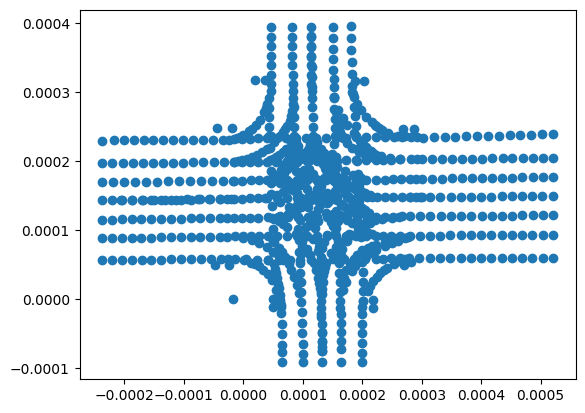

In [45]:
import matplotlib.pyplot as plt

lat, lon = zip(*handler.nodes)
plt.scatter(lon, lat)  # Longitudes and latitudes
plt.show()

/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([
/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:64: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  [asarray(r)[:, :2] for r in t.interiors])
/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:46: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  polygon = [Polygon(p) for p in polygon]


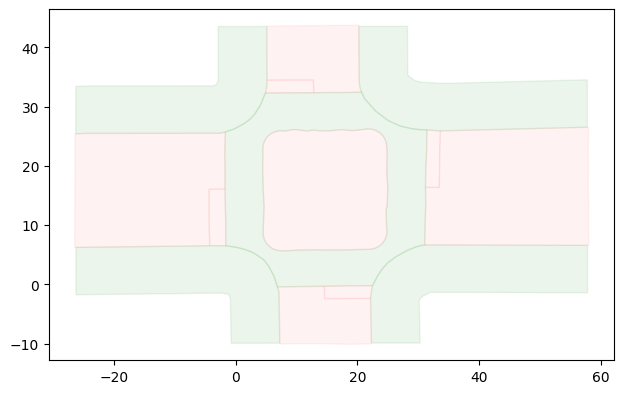

In [49]:
from example_code.data.map import SinD_map

map_instance = SinD_map()
ax = map_instance.plot_areas()
plt.show()

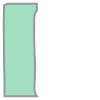

In [50]:
from example_code.data.poly_process import crosswalk_poly_for_label as cpfl

map = SinD_map()
cpfl(map)[0]

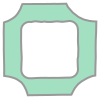

In [51]:
map.crosswalk_poly

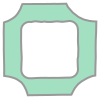

In [52]:
map.crosswalk_poly

# Labeling Function

In [53]:
from shapely.geometry import LineString, Point
import numpy as np
from math import pi
from tqdm import tqdm
import os

In [54]:
ROOT = os.path.dirname(os.getcwd()) + "/resources"
LABELS = {
    "cross_left": 0,
    "cross_right": 1,
    "cross_straight": 2,
    "cross_illegal": 3,
    "crossing_now": 4,
    "not_cross": 5,
    "unknown": 6,
}

In [55]:
def angle_between_angles(a1: float, a2: float):
    """Calculate interior angle between two angles

    Parameters:
    -----------
    a1 : float
        The first heading (angle)
    a2 : float
        The second heading (angle)
    """
    v = np.array([np.cos(a1), np.sin(a1)])
    w = np.array([np.cos(a2), np.sin(a2)])
    return np.math.atan2(np.linalg.det([v, w]), np.dot(v, w))


In [56]:
def labels(
    map,
    data: np.ndarray,
    input_len: int = 30,
    save_data: bool = True,
    disable_progress_bar: bool = False,
):
    _labels = []
    _crosswalks = cpfl(map)
    for _data in tqdm(data, desc="Labeling data", disable=disable_progress_bar):
        _x, _y = _data[0:input_len], _data[input_len : 2 * input_len]
        _l = LineString(list(zip(_x, _y)))
        _avg_angle = np.arctan2(sum(_y[2:6] - _y[0:4]), sum(_x[2:6] - _x[0:4]))
        _avg_angle_end = np.arctan2(
            sum(_y[-6:-2] - _y[-4:]), sum(_x[-6:-2] - _x[-4:])
        )
        if (
            (_l.crosses(_crosswalks[0]) or _l.crosses(_crosswalks[2]))
            and not (
                _l.crosses(map.road_poly)
                or _l.crosses(map.intersection_poly)
                or _l.crosses(map.gap_poly)
            )
            and Point((_x[0], _y[0])).within(map.sidewalk_poly)
        ):
            if (_avg_angle > pi / 4 and _avg_angle < 3 * pi / 4) or (
                _avg_angle > -3 * pi / 4 and _avg_angle < -pi / 4
            ):
                _labels.append(LABELS["cross_straight"])
            elif _avg_angle >= -pi / 4 and _avg_angle <= pi / 4:
                if _y[0] < 16:
                    _labels.append(LABELS["cross_left"])
                elif _y[0] >= 16:
                    _labels.append(LABELS["cross_right"])
            else:
                if _y[0] < 16:
                    _labels.append(LABELS["cross_right"])
                elif _y[0] >= 16:
                    _labels.append(LABELS["cross_left"])
        elif (
            (_l.crosses(_crosswalks[1]) or _l.crosses(_crosswalks[3]))
            and not (
                _l.crosses(map.road_poly)
                or _l.crosses(map.intersection_poly)
                or _l.crosses(map.gap_poly)
            )
            and Point((_x[0], _y[0])).within(map.sidewalk_poly)
        ):
            if (_avg_angle > -pi / 4 and _avg_angle < pi / 4) or (
                _avg_angle > 3 * pi / 4 or _avg_angle < -3 * pi / 4
            ):
                _labels.append(LABELS["cross_straight"])
            elif _avg_angle > pi / 4 and _avg_angle < 3 * pi / 4:
                if _x[0] < 14:
                    _labels.append(LABELS["cross_right"])
                elif _x[0] >= 14:
                    _labels.append(LABELS["cross_left"])
            else:
                if _x[0] < 14:
                    _labels.append(LABELS["cross_left"])
                elif _x[0] >= 14:
                    _labels.append(LABELS["cross_right"])
        elif _l.within(map.crosswalk_poly):
            _labels.append(LABELS["crossing_now"])
        elif _l.within(map.sidewalk_poly):
            _labels.append(LABELS["not_cross"])
        elif (
            _l.intersects(map.road_poly)
            or _l.intersects(map.intersection_poly)
            or _l.intersects(map.gap_poly)
        ):
            _labels.append(LABELS["cross_illegal"])
        elif Point((_x[0], _y[0])).within(map.crosswalk_poly) and not (
            _l.intersects(map.road_poly)
            or _l.intersects(map.intersection_poly)
            or _l.intersects(map.gap_poly)
        ):
            if Point((_x[-1], _y[-1])).within(map.sidewalk_poly):
                _labels.append(LABELS["not_cross"])
            else:
                _labels.append(LABELS["unknown"])
        elif Point((_x[0], _y[0])).within(map.sidewalk_poly) and not (
            _l.intersects(map.road_poly)
            or _l.intersects(map.intersection_poly)
            or _l.intersects(map.gap_poly)
        ):
            if Point((_x[-1], _y[-1])).within(map.crosswalk_poly):
                _angle_diff = angle_between_angles(_avg_angle, _avg_angle_end)
                if np.abs(_angle_diff) < pi / 4 and (
                    (
                        _avg_angle > pi / 4
                        and _avg_angle < 3 * pi / 4
                        and _avg_angle_end > pi / 4
                        and _avg_angle_end < 3 * pi / 4
                    )
                    or (
                        _avg_angle > -3 * pi / 4
                        and _avg_angle < -pi / 4
                        and _avg_angle_end > -3 * pi / 4
                        and _avg_angle_end < -pi / 4
                    )
                    or (
                        _avg_angle > -pi / 4
                        and _avg_angle < pi / 4
                        and _avg_angle_end > -pi / 4
                        and _avg_angle_end < pi / 4
                    )
                    or (
                        (_avg_angle > 3 * pi / 4 or _avg_angle < -3 * pi / 4)
                        and (
                            _avg_angle_end > 3 * pi / 4
                            or _avg_angle_end < -3 * pi / 4
                        )
                    )
                ):
                    _labels.append(LABELS["cross_straight"])
                elif _angle_diff < -pi / 4 and _angle_diff > -3 * pi / 4:
                    _labels.append(LABELS["cross_right"])
                elif _angle_diff > pi / 4 and _angle_diff < 3 * pi / 4:
                    _labels.append(LABELS["cross_left"])
                else:
                    _labels.append(LABELS["unknown"])
            else:
                _labels.append(LABELS["unknown"])
        else:
            _labels.append(LABELS["unknown"])
    if save_data:
        _f = open(ROOT + "/sind_labels.pkl", "wb")
        pickle.dump(np.array(_labels), _f)
    return np.array(_labels)

In [57]:
_labels = labels(map, data, 90, False, False)

Labeling data:   0%|          | 0/513136 [00:00<?, ?it/s]

Labeling data:   1%|          | 4164/513136 [00:01<02:19, 3646.00it/s]/tmp/ipykernel_96324/193676193.py:13: DeprecationWarning: `np.math` is a deprecated alias for the standard library `math` module (Deprecated Numpy 1.25). Replace usages of `np.math` with `math`
  return np.math.atan2(np.linalg.det([v, w]), np.dot(v, w))
Labeling data: 100%|██████████| 513136/513136 [03:05<00:00, 2758.97it/s]


In [58]:
len(_labels)

513136

In [59]:
data.shape

(513136, 540)

# Plot Data

In [60]:
from example_code.data.data_reader import SinD
sind = SinD()

In [61]:
check_id = 10

In [62]:
def plot_dataset(map, pedestrian_data, map_overlay: bool = True, alpha: float = 0.2):
    # Create a single figure
    fig = plt.figure(figsize=(7*3, 6))  # Adjust figure size as needed

    # Add subplots on the same row. All three plots will now be in the same row.
    ax1 = fig.add_subplot(1, 3, 1, projection='3d')  # First plot, 3D
    ax2 = fig.add_subplot(1, 3, 2)  # Second plot, 2D
    ax3 = fig.add_subplot(1, 3, 3, projection='3d')  # Third plot, 3D

    # Plot map areas on ax2 if map_overlay is True
    if map_overlay:
        map.plot_areas(alpha=alpha, ax=ax2)  # Adjust this call according to your map object's API
    ax2.set_title("Pedestrian trajectories")

    for _id in pedestrian_data.keys():
        x, y = np.array(pedestrian_data[_id]["x"]), np.array(pedestrian_data[_id]["y"])
        vx, vy = pedestrian_data[_id]["vx"], pedestrian_data[_id]["vy"]
        ax, ay = pedestrian_data[_id]["ax"], pedestrian_data[_id]["ay"]
        v = np.sqrt(np.array(vx).T ** 2 + np.array(vy).T ** 2)
        a = np.sqrt(np.array(ax).T ** 2 + np.array(ay).T ** 2)

        # Plotting on ax1 for velocity profile
        ax1.plot(x, y, zs=v, c="r")
        ax1.set_title("Velocity profile of trajectories")
        ax1.set_xlabel('X')
        ax1.set_ylabel('Y')
        ax1.set_zlabel('V')
        ax1.set_xlim(0, 30)
        ax1.set_ylim(0, 30)
        ax1.set_zlim(0, 5)

        # Plotting pedestrian trajectories on ax2
        ax2.plot(x, y, c="orange")

        # Plotting on ax3 for acceleration profile
        ax3.plot(x, y, zs=a, c="r")
        ax3.set_title("Acceleration profile of trajectories")
        ax3.set_xlabel('X')
        ax3.set_ylabel('Y')
        ax3.set_zlabel('A')
        ax3.set_xlim(0, 30)
        ax3.set_ylim(0, 30)
        ax3.set_zlim(0, 5)

    plt.show()


/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([
/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:64: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  [asarray(r)[:, :2] for r in t.interiors])
/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:46: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  polygon = [Polygon(p) for p in polygon]


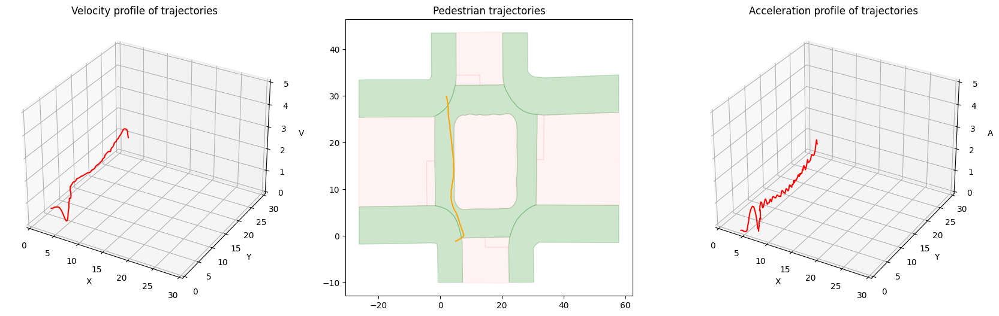

In [63]:
plot_dataset(map=map, pedestrian_data={check_id: sind.pedestrian_data[check_id]})

In [64]:
print(_labels[check_id])
for key, idx in LABELS.items():
    if idx == _labels[check_id]: print(key)

3
cross_illegal


In [65]:
category_names = {v: k for k, v in LABELS.items()}
named_categories = np.array([category_names[num] for num in _labels])
category_counts = pd.Series(named_categories).value_counts()

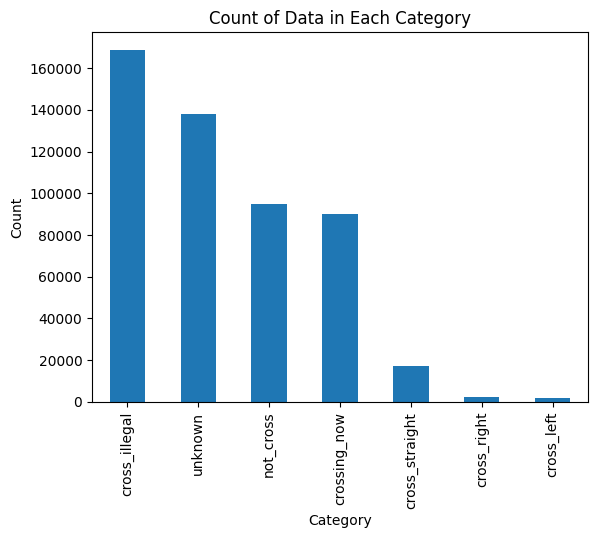

In [66]:
import matplotlib.pyplot as plt

# Create a bar plot
category_counts.plot(kind='bar')

# Add labels and title (optional)
plt.xlabel('Category')
plt.ylabel('Count')
plt.title('Count of Data in Each Category')

# Show the plot
plt.show()

# Analyze Labels Function

In [67]:
sind.pedestrian_data[10]['y']

3820    29.938210
3821    29.853756
3822    29.741423
3823    29.626017
3824    29.501406
          ...    
4085    -0.976670
4086    -1.010128
4087    -1.036145
4088    -1.073393
4089    -1.111686
Name: y, Length: 270, dtype: float64

/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([
/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:64: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  [asarray(r)[:, :2] for r in t.interiors])
/home/kfragkedaki/miniconda3/envs/pedestrian_project/lib/python3.9/site-packages/descartes/patch.py:46: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  polygon = [Polygon(p) for p in polygon]


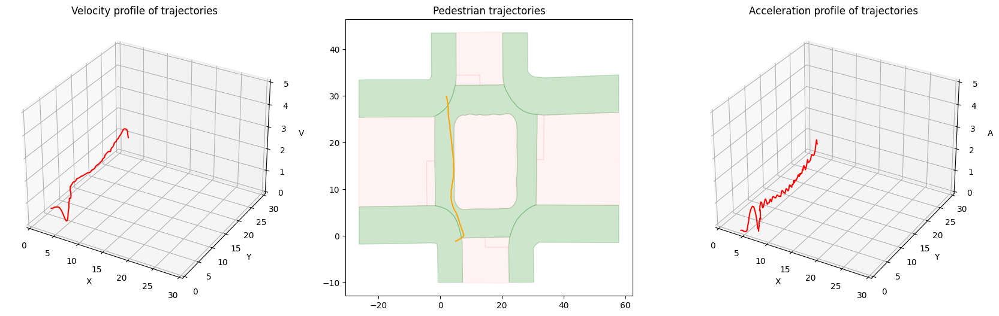

In [68]:
plot_dataset(map, pedestrian_data={10: sind.pedestrian_data[10]})

In [69]:
data[0].shape

(540,)

In [70]:
_data = data[10*(0-90)]
input_len = 90

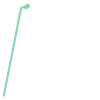

In [71]:
_x, _y = _data[0:input_len], _data[input_len : 2 * input_len]
LineString(list(zip(_x, _y)))

In [72]:
Point((_x[0], _y[0])).within(map.sidewalk_poly)

True

In [73]:
_avg_angle = np.arctan2(sum(_y[2:6] - _y[0:4]), sum(_x[2:6] - _x[0:4]))
_avg_angle

1.3769651807276317

In [74]:
_avg_angle_end = np.arctan2(
                sum(_y[-6:-2] - _y[-4:]), sum(_x[-6:-2] - _x[-4:])
            )
_avg_angle_end

-2.309213296824589

In [75]:
len(_y), len(_y[2:6]), len(_y[0:4]), len(_y[-6:-2]), len(_y[-4:])

(90, 4, 4, 4, 4)

In [76]:
_y[0:4], _y[2:6]

(array([-2.91213147, -2.88990525, -2.86767903, -2.84545282]),
 array([-2.86767903, -2.84545282, -2.8232266 , -2.80100038]))

In [77]:
_y[-6:-2], _y[-4:]

(array([-1.58036749, -1.5708419 , -1.56069308, -1.55215306]),
 array([-1.56069308, -1.55215306, -1.53987341, -1.5296187 ]))

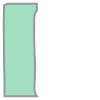

In [78]:
_crosswalks = cpfl(map)
_crosswalks[0]

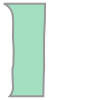

In [79]:
_crosswalks[2]

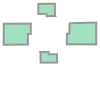

In [80]:
map.road_poly

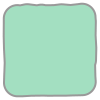

In [81]:
map.intersection_poly

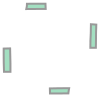

In [82]:
map.gap_poly

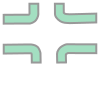

In [83]:
map.sidewalk_poly

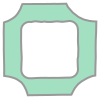

In [84]:
map.crosswalk_poly

In [85]:
Point((_x[0], _y[0])).within(map.sidewalk_poly[3]), Point((_x[0], _y[0])).touches(map.sidewalk_poly[3])

/tmp/ipykernel_96324/1762231741.py:1: ShapelyDeprecationWarning: __getitem__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  Point((_x[0], _y[0])).within(map.sidewalk_poly[3]), Point((_x[0], _y[0])).touches(map.sidewalk_poly[3])


(False, False)

In [86]:
Point((_x[0], _y[0])).coords[0]

(23.4384348785394, -2.9121314654761)

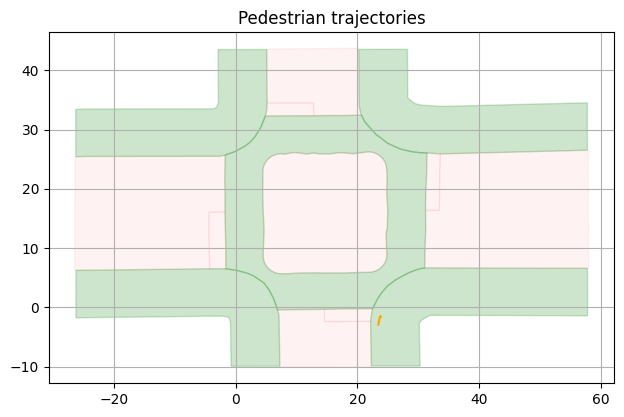

In [88]:
ax2 = map.plot_areas(alpha=0.2)
ax2.plot(_x, _y, c="orange"), ax2.set_title("Pedestrian trajectories")

plt.grid()
plt.show()